# Advanced Lane Finding Project 

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

In [5]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:98% !important; }</style>"))
%matplotlib inline
# %matplotlib qt
%load_ext autoreload
%autoreload 2

import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import pickle
import sys, os, pprint
from classes.camera   import Camera
from classes.line     import Line 
from classes.plotting import PlotDisplay

from classes.calibration import CalibrationImage
from common.utils   import display_one, display_two
from common.sobel   import *

pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())


imageNames = glob.glob('./camera_cal/calibration*.jpg')
imageCount = len(imageNames)
imageIndexes = range(imageCount)
pp.pprint(imageNames)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Current working dir:  E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines
[ './camera_cal\\calibration1.jpg',
  './camera_cal\\calibration10.jpg',
  './camera_cal\\calibration11.jpg',
  './camera_cal\\calibration12.jpg',
  './camera_cal\\calibration13.jpg',
  './camera_cal\\calibration14.jpg',
  './camera_cal\\calibration15.jpg',
  './camera_cal\\calibration16.jpg',
  './camera_cal\\calibration17.jpg',
  './camera_cal\\calibration18.jpg',
  './camera_cal\\calibration19.jpg',
  './camera_cal\\calibration2.jpg',
  './camera_cal\\calibration20.jpg',
  './camera_cal\\calibration3.jpg',
  './camera_cal\\calibration4.jpg',
  './camera_cal\\calibration5.jpg',
  './camera_cal\\calibration6.jpg',
  './camera_cal\\calibration7.jpg',
  './camera_cal\\calibration8.jpg',
  './camera_cal\\calibration9.jpg']


# Camera Calibration - I

nx, ny parameters are set to (9,6). Images which fail the corner detection process with these parameters are excluded from the camera calibration process.

##  Instantiate `Camera` Class

In [13]:
try: 
    del camera0
except: 
    print(' Camera object doesnt exist')
finally:
    camera0 = Camera(width = 1280, height = 720)
    print(' Camera object created')


 Camera object created


## Read chessboard images and detect corners

Here we attempt to detect corners using the parms `nx = 9` and `ny = 6` for ALL calibration images.

Images that fail the corner detection process are discarded 

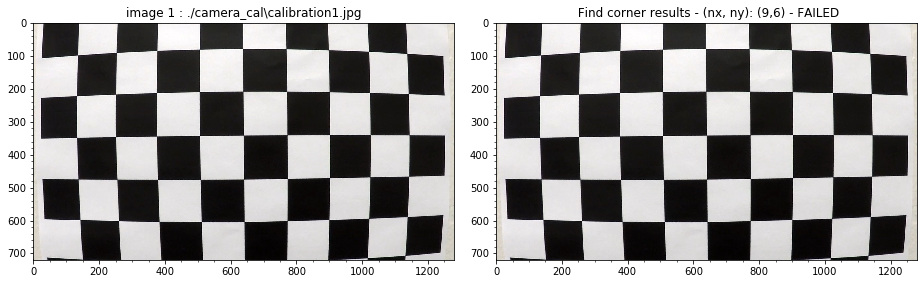

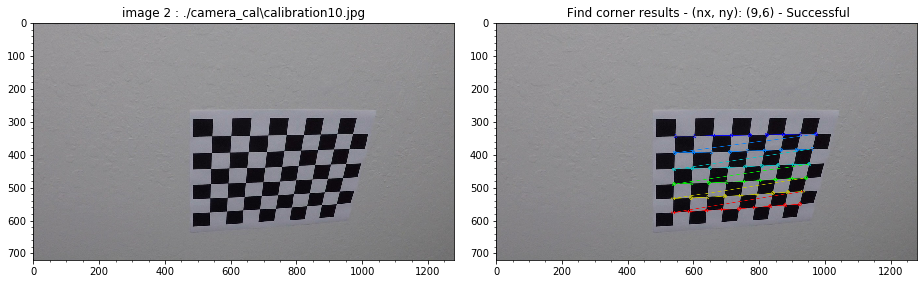

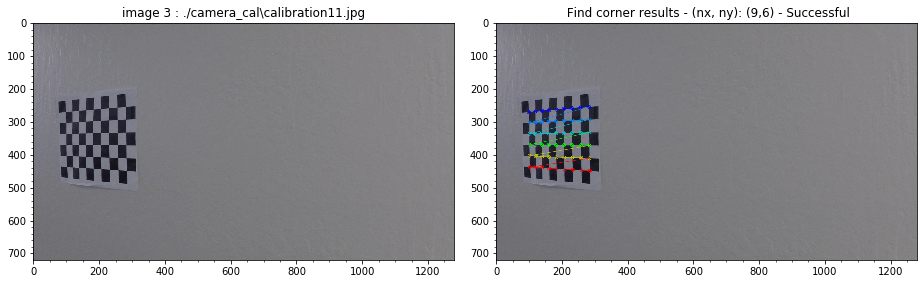

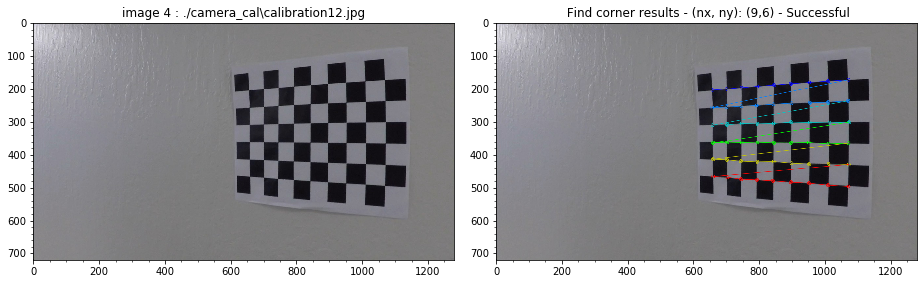

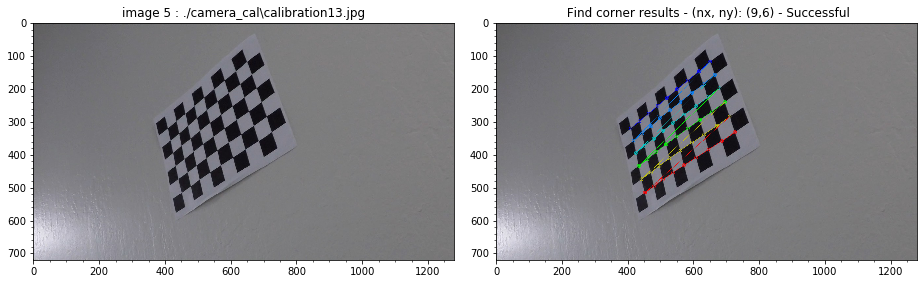

...

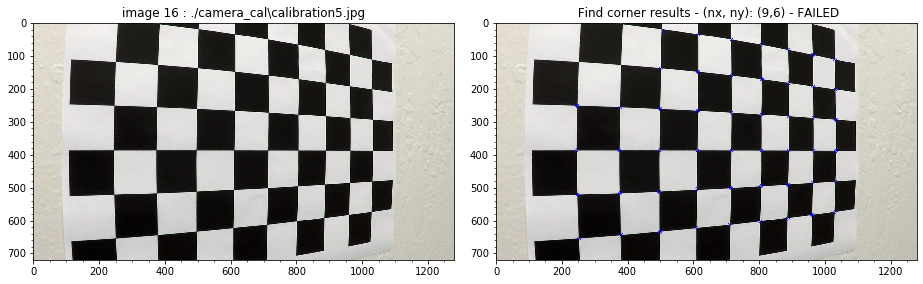

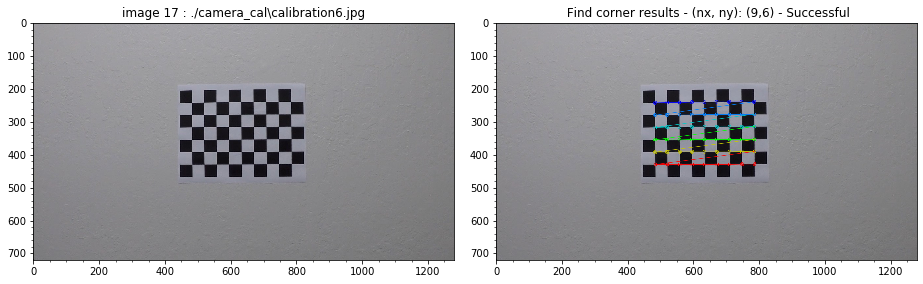

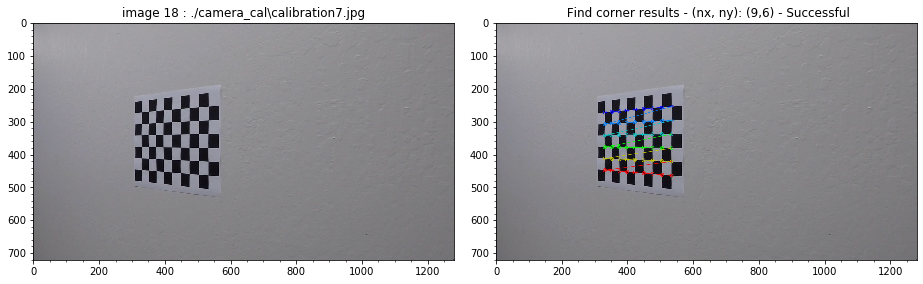

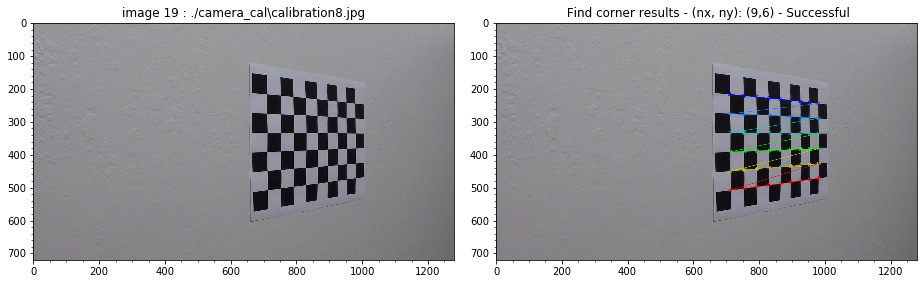

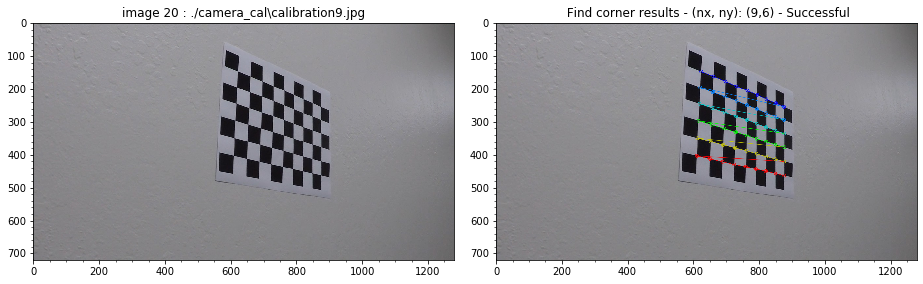

In [58]:
calImages = []
nx = 9; ny = 6

# for idx, imageName in enumerate(imageNames):  

for idx in range(imageCount): 
# for idx in [0,1,2]:
    imageName = imageNames[idx]
    image = CalibrationImage(imageName)
#     print('\n idx: ', idx, ' Calibration image ', idx+1 ,' File name: ', imageName)
    
    ret = image.findChessboardCorners(nx,ny, save = True, debug = False)
    
    if ret: 
        calImages.append(image)        
    
    _, dispImg  = image.displayChessboardCorners()
    display_two(image.imgOrig, dispImg, size=(13,7),
            title1 = 'image '+str(idx+1)+' : '+image.filename,
            title2 = ' Find corner results - (nx, ny): (' +str(image.nx)+',' +str(image.ny)+')'+ (' - Successful' if ret else ' - FAILED'))           
        

## Calibrate Camera 

Using the checkerboard transformation points from images that were sucessfully corner detected 

In [15]:
camera0.calibrate(calImages)

 Camera Parameters: 
------------------------------
 RMS reprojection error   :  1.0298149716172809

 Camera Matrix          :  (3, 3) 
 [[1.15777818e+03 0.00000000e+00 6.67113856e+02]
 [0.00000000e+00 1.15282217e+03 3.86124583e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]

 Distortion Coefficients:  [[-0.24688507 -0.02373154 -0.00109831  0.00035107 -0.00259868]]

 Rotation Vectors       :  <class 'list'> 17   *  (3, 1)
    0 :  [[ 0.50881049 -0.21913637  0.02925031]]
    1 :  [[0.0340257  0.45851293 0.00531513]]
    2 :  [[0.03491565 0.65175488 0.00975186]]
    3 :  [[-0.33009432  0.66083096 -0.4156368 ]]
    4 :  [[ 0.05512178 -0.51768678 -0.00421075]]
    5 :  [[-0.02341925 -0.48743959  0.02025372]]
    6 :  [[ 0.03795605 -0.4639104  -0.05634147]]
    7 :  [[ 0.21392273 -0.06381126  0.01147972]]
    8 :  [[ 0.18014885 -0.05109107 -0.00119253]]
    9 :  [[0.08576683 0.38442539 0.05432059]]
    10 :  [[ 0.63302921 -0.04811505  0.01736486]]
    11 :  [[-0.02312669  0.38311823 -

## Display Undistorted Calibration Images & detected corners 

### Display undistorted images with detected corner points

 idx:  0  Filename : ./camera_cal\calibration10.jpg    nx:  9    ny:  6


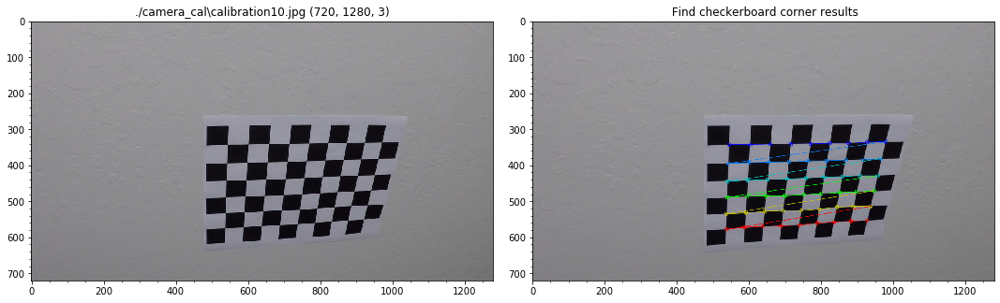

 idx:  1  Filename : ./camera_cal\calibration11.jpg    nx:  9    ny:  6


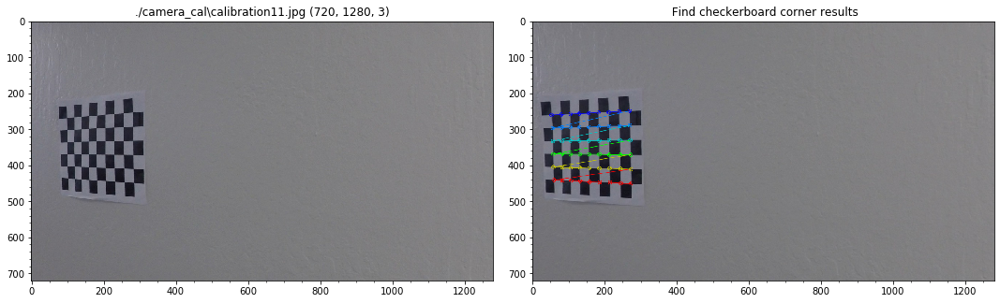

 idx:  2  Filename : ./camera_cal\calibration12.jpg    nx:  9    ny:  6


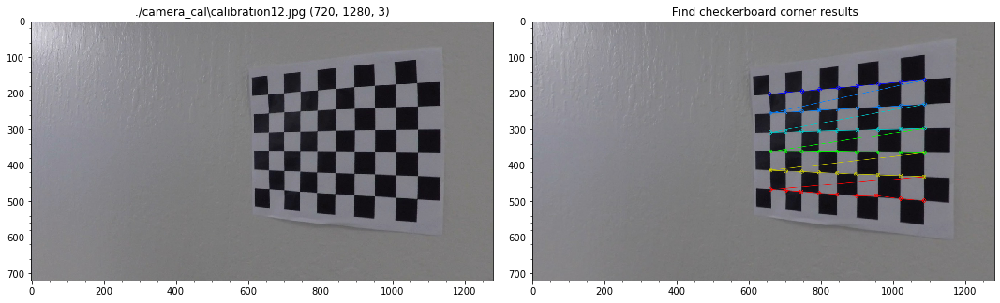

 idx:  3  Filename : ./camera_cal\calibration13.jpg    nx:  9    ny:  6


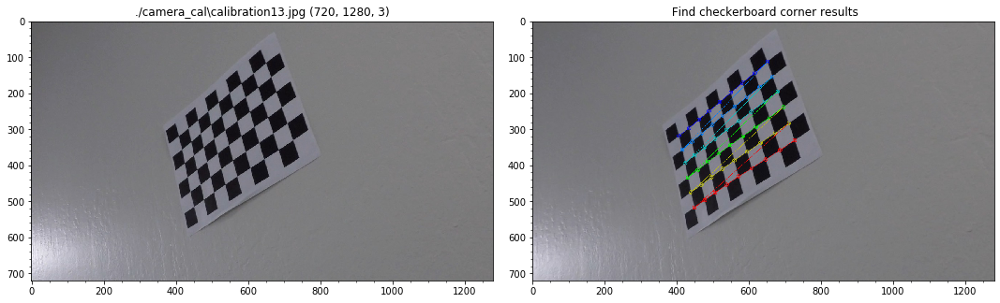

 idx:  4  Filename : ./camera_cal\calibration14.jpg    nx:  9    ny:  6


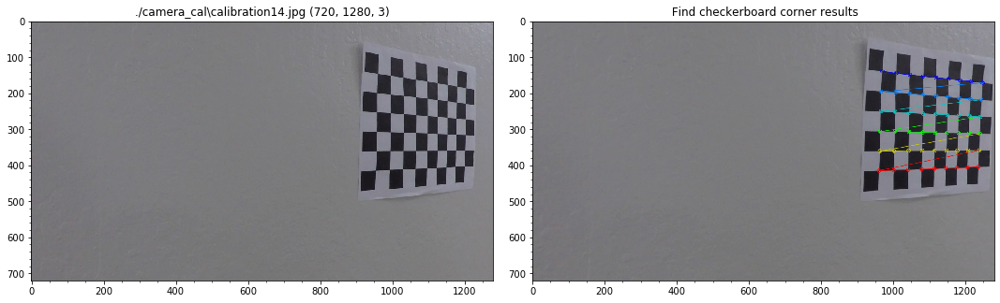

 idx:  5  Filename : ./camera_cal\calibration15.jpg    nx:  9    ny:  6


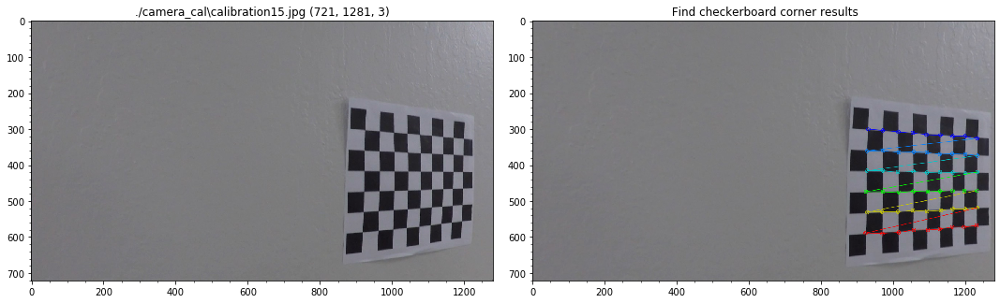

 idx:  6  Filename : ./camera_cal\calibration16.jpg    nx:  9    ny:  6


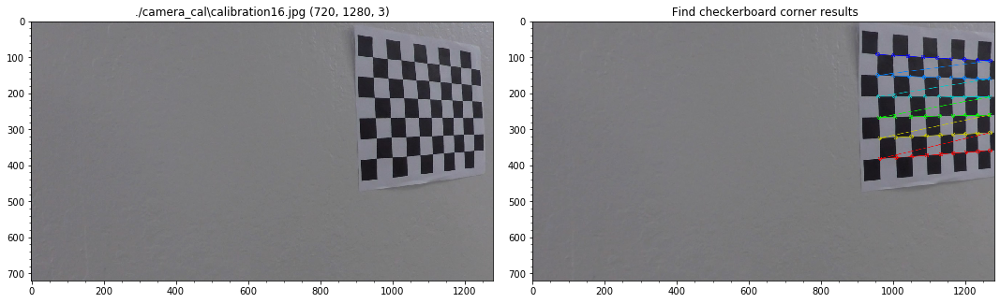

 idx:  7  Filename : ./camera_cal\calibration17.jpg    nx:  9    ny:  6


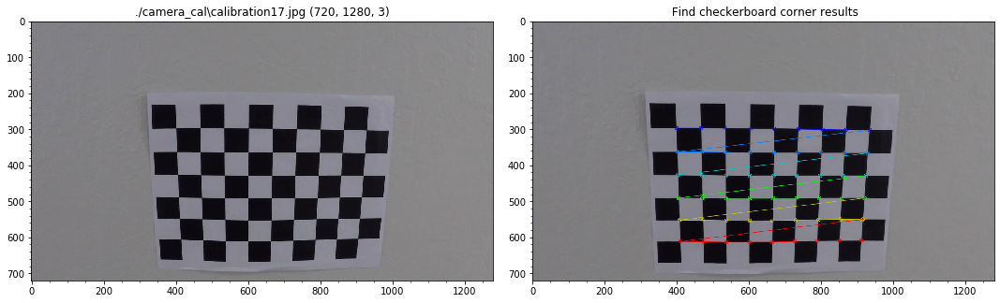

 idx:  8  Filename : ./camera_cal\calibration18.jpg    nx:  9    ny:  6


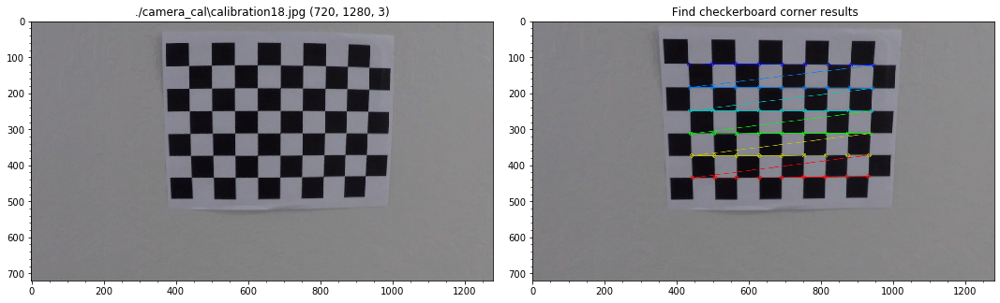

 idx:  9  Filename : ./camera_cal\calibration19.jpg    nx:  9    ny:  6


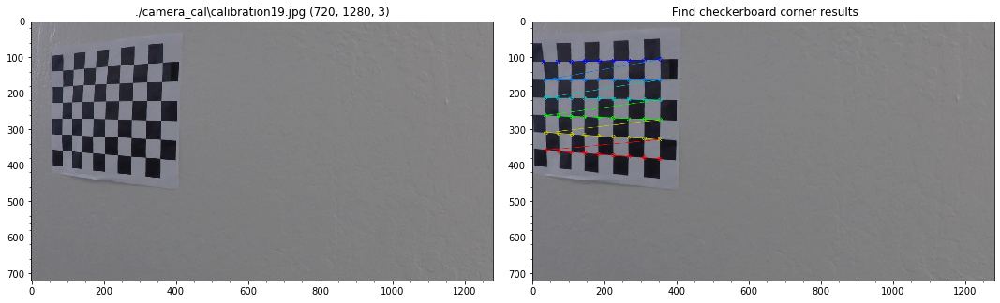

 idx:  10  Filename : ./camera_cal\calibration2.jpg    nx:  9    ny:  6


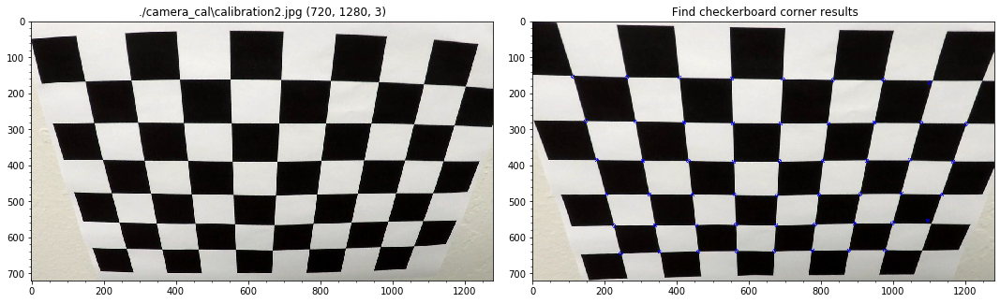

 idx:  11  Filename : ./camera_cal\calibration20.jpg    nx:  9    ny:  6


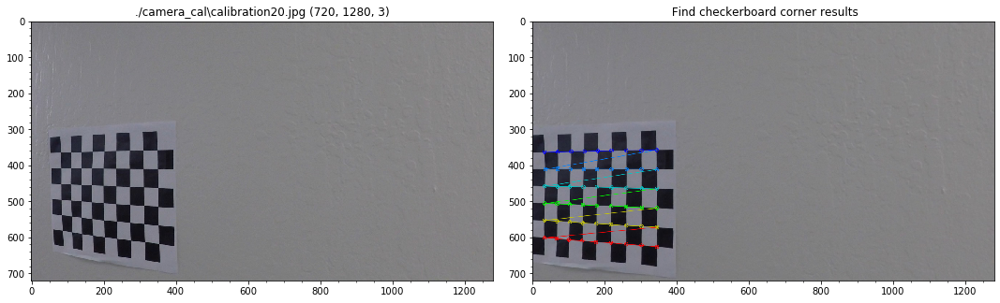

 idx:  12  Filename : ./camera_cal\calibration3.jpg    nx:  9    ny:  6


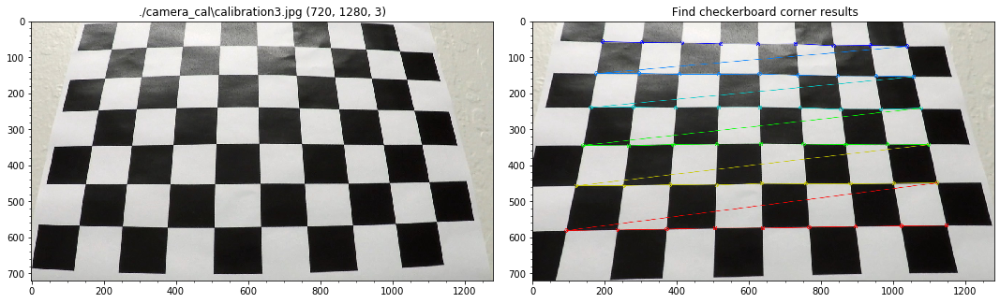

 idx:  13  Filename : ./camera_cal\calibration6.jpg    nx:  9    ny:  6


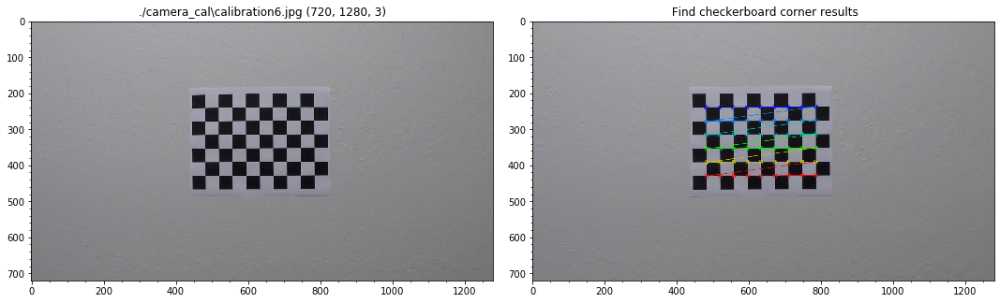

 idx:  14  Filename : ./camera_cal\calibration7.jpg    nx:  9    ny:  6


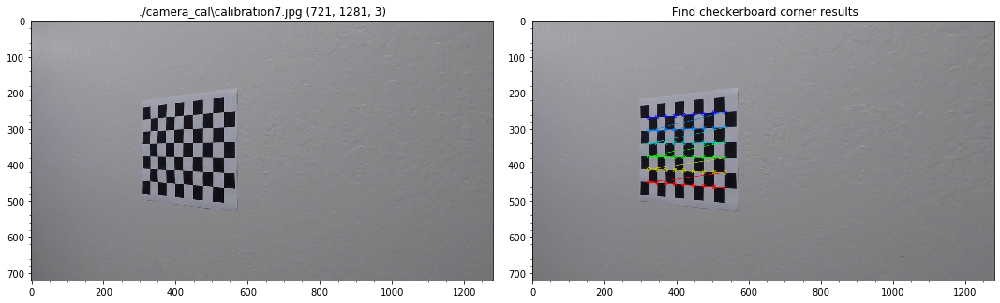

 idx:  15  Filename : ./camera_cal\calibration8.jpg    nx:  9    ny:  6


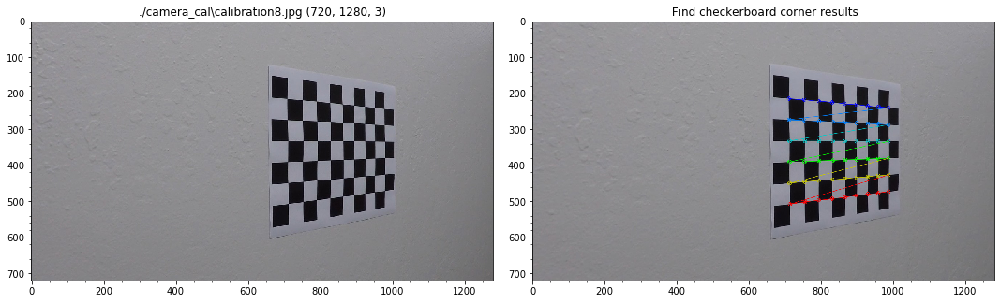

 idx:  16  Filename : ./camera_cal\calibration9.jpg    nx:  9    ny:  6


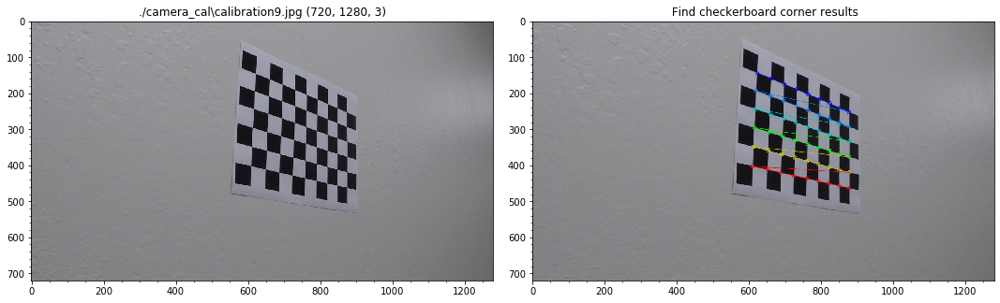

In [32]:
nx = 9; ny = 6
for idx,image in enumerate(calImages):
    print(' idx: ', idx, ' Filename :', image.filename, '   nx: ', nx, '   ny: ', ny)
    inputImg, dispImg  = image.displayChessboardCorners(undistort = True, cam = camera0, nx = nx, ny = ny, debug = False)
    display_two(image.imgOrig, dispImg, size=(15,10),
                title1 = image.filename + ' '+str(image.imgOrig.shape), title2 = ' Find checkerboard corner results')    

### Display undistorted images with detected corner points

 idx:  0  Filename : ./camera_cal\calibration1.jpg    nx:  9    ny:  5


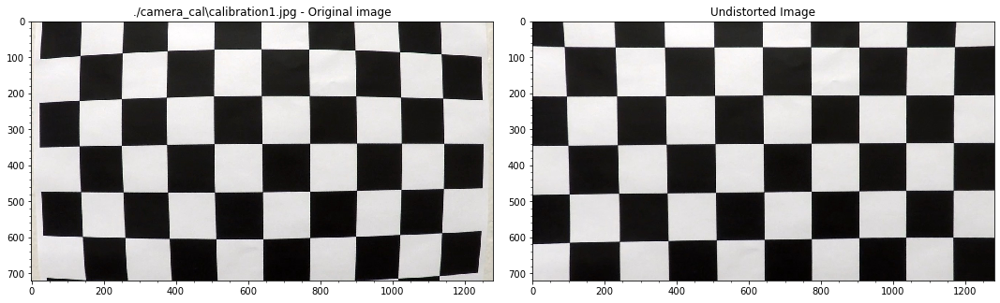

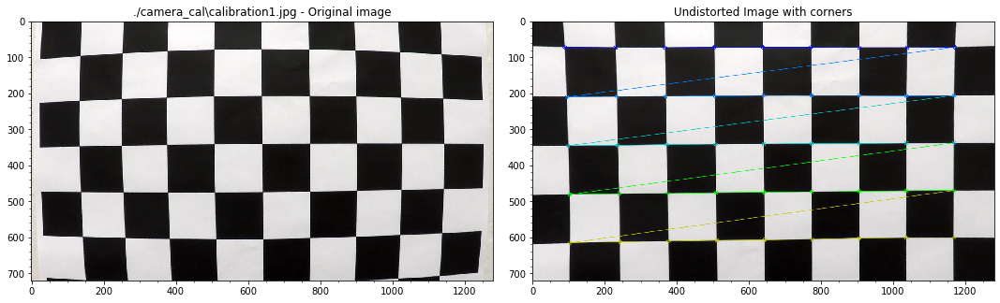

 idx:  -5  Filename : ./camera_cal\calibration5.jpg    nx:  8    ny:  4


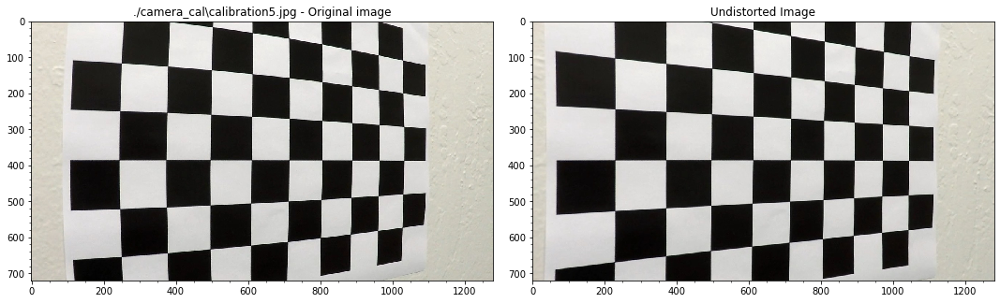

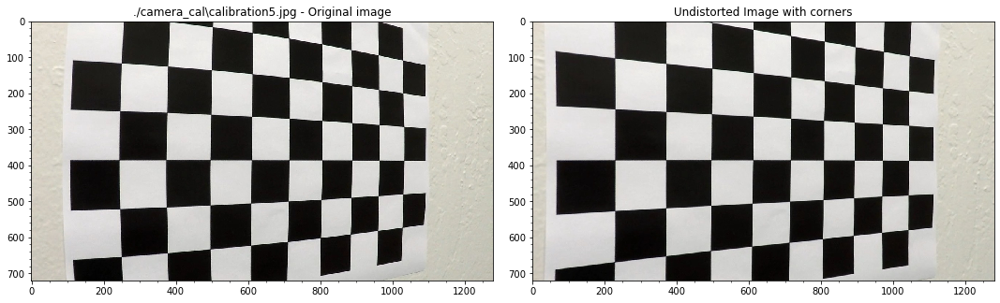

 idx:  -6  Filename : ./camera_cal\calibration4.jpg    nx:  8    ny:  6


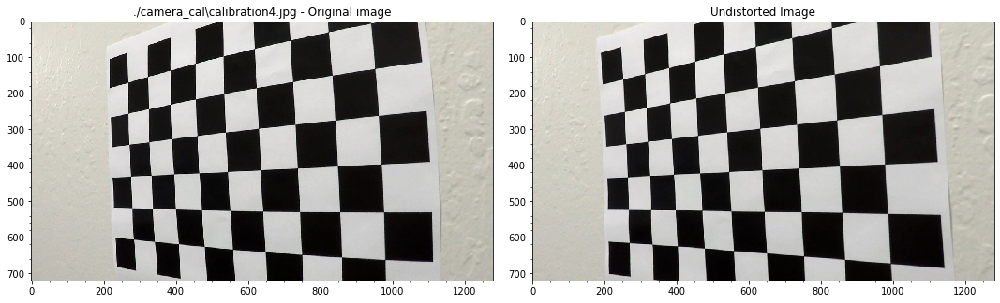

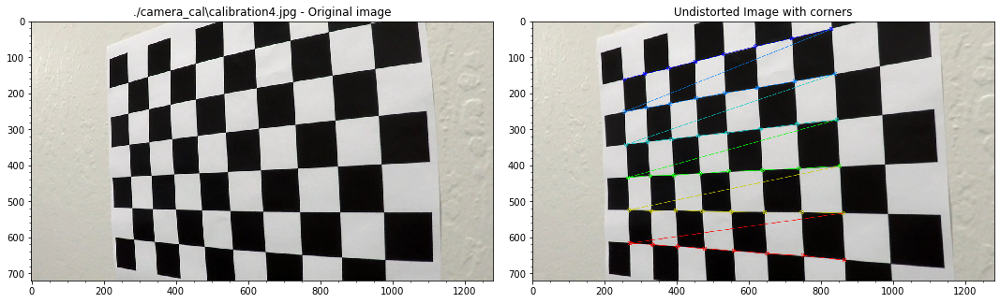

In [55]:
for idx,  (nx,ny) in zip([0,-5,-6,], [(9,5), (8,4), (8,6) ]):
            image = CalibrationImage(imageNames[idx])
            print(' idx: ', idx, ' Filename :', imageNames[idx], '   nx: ', nx, '   ny: ', ny)
            ret, distImgCorners = image.displayChessboardCorners(undistort = True, cam = camera0, nx = nx, ny = ny, debug = False)
            undistImg = camera0.undistortImage(image.imgOrig)
            display_two(image.imgOrig, undistImg, size = (15,10),
                        title1 = image.filename+ ' - Original image' , title2 = 'Undistorted Image')    
            
            ret, undistImgCorners = image.displayChessboardCorners(undistort = True, cam = camera0, nx = nx, ny = ny, debug = False)
            display_two(image.imgOrig, undistImgCorners, size = (15,10),
                        title1 = image.filename+ ' - Original image' , title2 = 'Undistorted Image with corners')    


## Undistort Images
(Needs Camera Calibration params first)

Camera must be calibrated to run this code segment, as it attmepts to undistort an image

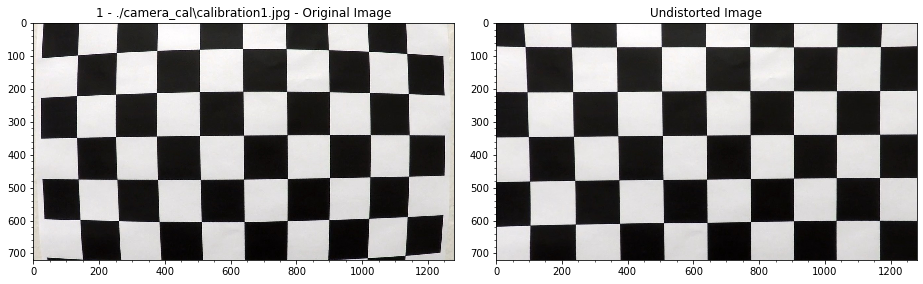

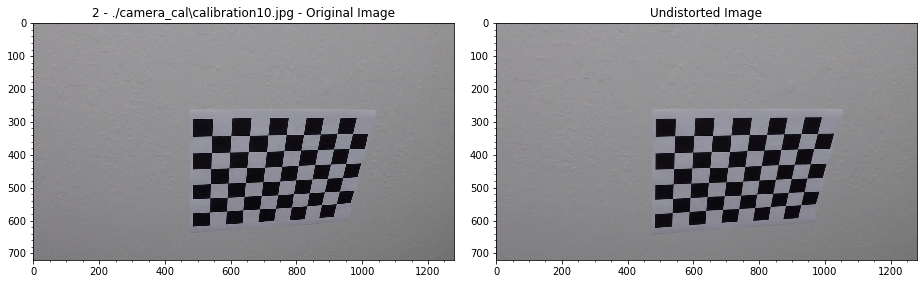

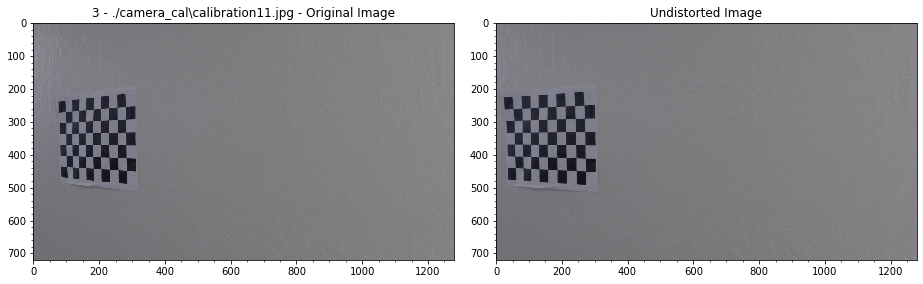

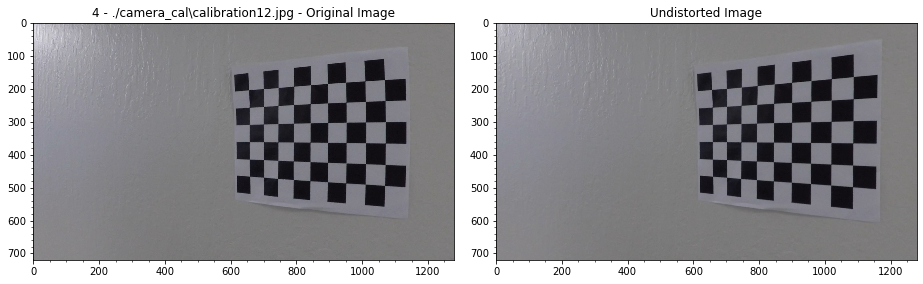

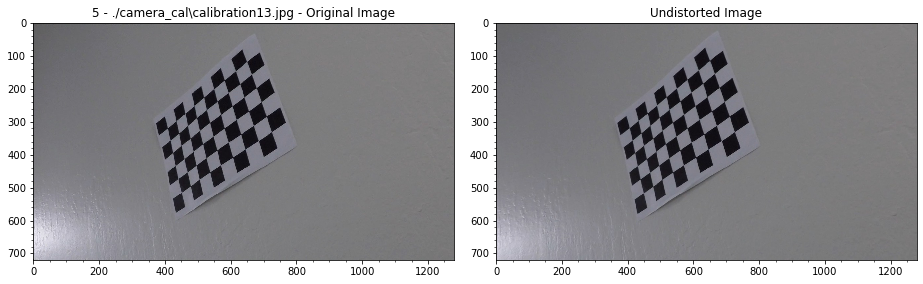

...

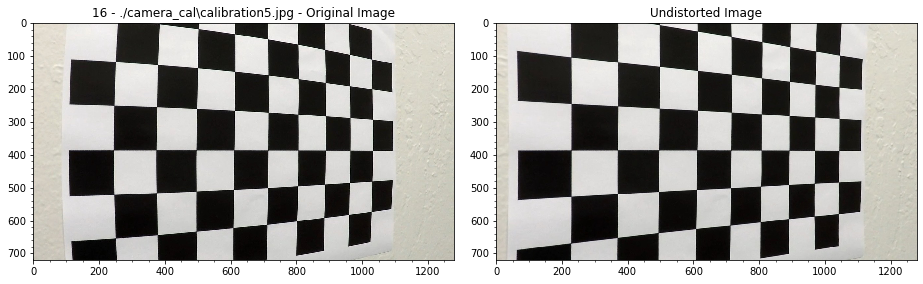

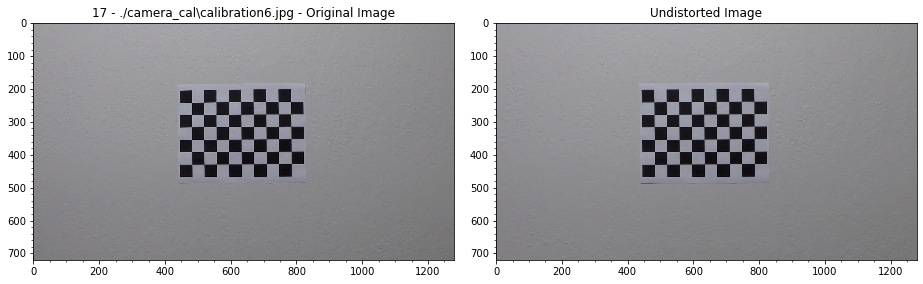

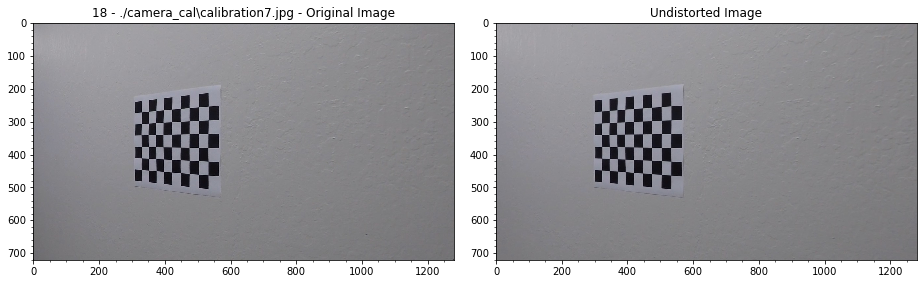

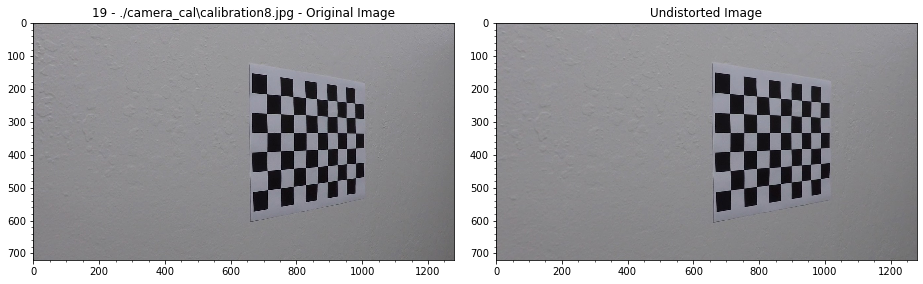

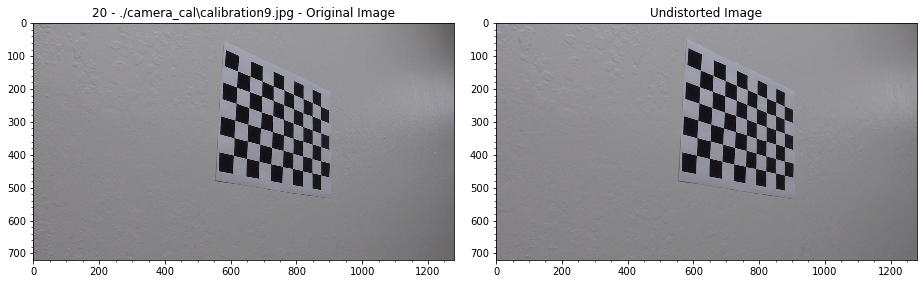

In [59]:
# for imgObj in calImages:
for idx in range(imageCount):
#     imgObj    = CalibrationImage(imageNames[idx])
#     inputImg = cv2.cvtColor(cv2.imread(filename) , cv2.COLOR_BGR2RGB)
    filename = imageList[idx]
    imgOrig = cv2.cvtColor(cv2.imread(filename) , cv2.COLOR_BGR2RGB)
    undistImg = camera0.undistortImage(imgOrig)
    if undistImg is not None: 
        display_two(imgOrig, undistImg, size=(13,7),
            title1 = str(idx+1)+' - '+ filename+' - Original Image',
            title2 = 'Undistorted Image')           
    else: 
        print('\n image filename: ',  filename, '  - Camera Undistort Failed')

## Save camera info to config file

`cameraconfig_0.pkl` : Calibration without considering images that failed in the Chessboard detection for nx = 9, ny = 6

`cameraconfig_1.pkl` : Calibration computed including images with nx/ny parms  other than nx = 9, ny = 6

In [49]:
with open('./cameraConfig_0_new.pkl', 'wb+') as outfile:
    pickle.dump(camera0, outfile)

## Load camera info from config file

In [8]:
imageList = glob.glob('./camera_cal/calibration*.jpg')
imageCount = len(imageList)
imageIndexes = range(imageCount)

In [9]:
try: 
    del camera0
except: 
    print(' object doesnt exist')
    pass
with open('./camera_cal/cameraConfig_0.pkl', 'rb') as infile:
    camera0 = pickle.load(infile)
print(camera0.cameraMatrix)

[[1.15777818e+03 0.00000000e+00 6.67113857e+02]
 [0.00000000e+00 1.15282217e+03 3.86124583e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


## Undistorted images

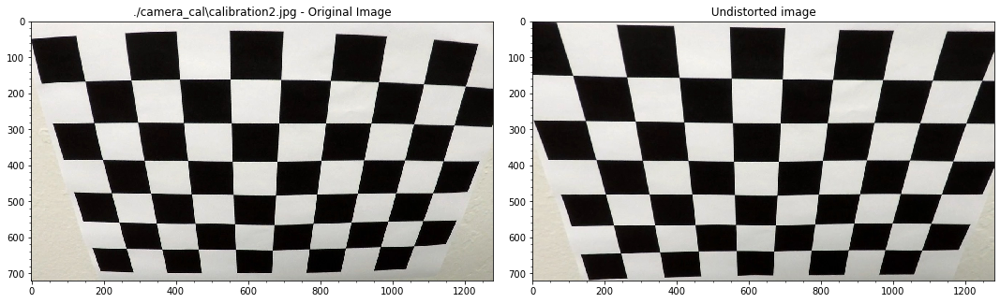

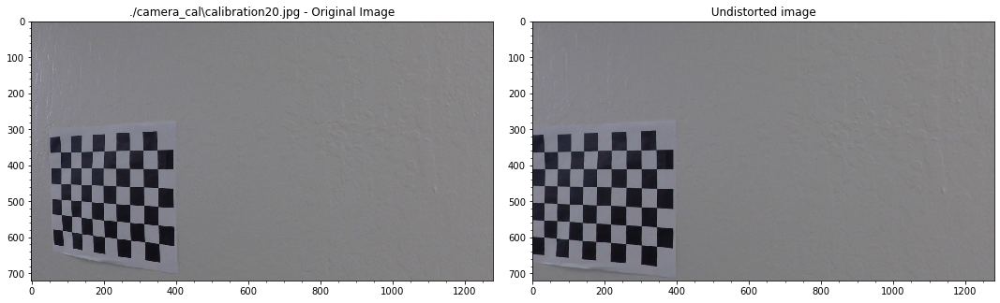

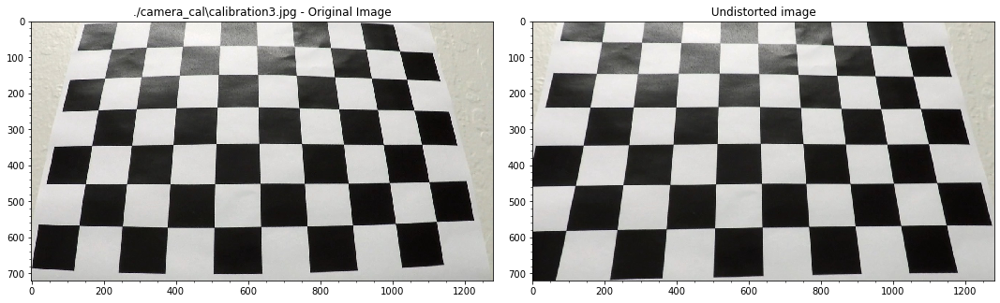

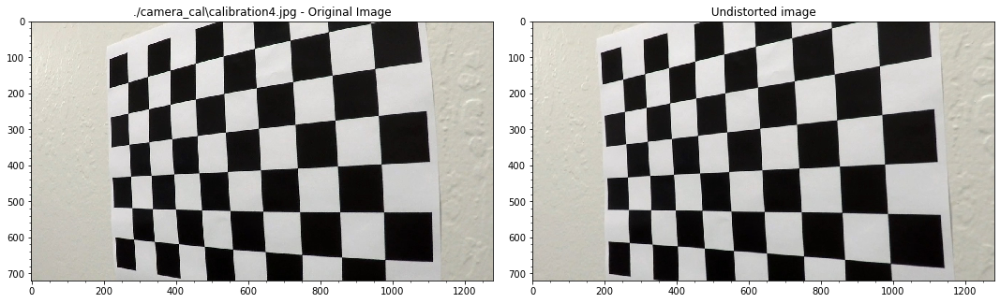

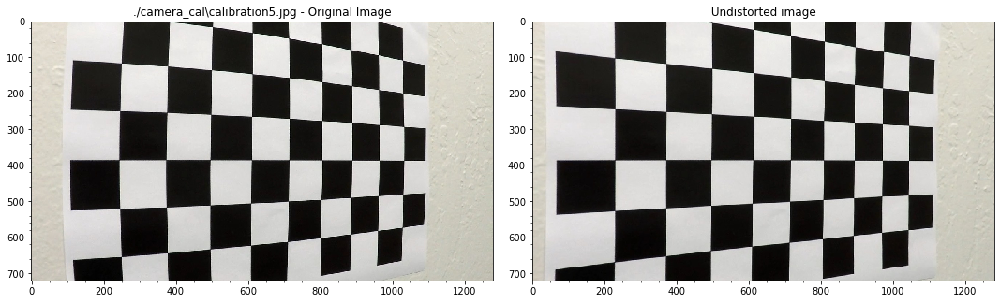

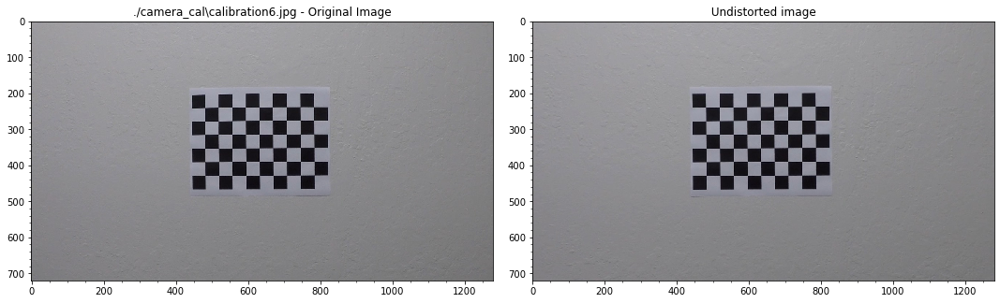

In [37]:
# %matplotlib inline
imgIdxs = [11,12,13,14,15,16]
for idx in imgIdxs:
#     inputImg = calImages[idx].getImage()
    filename = imageList[idx]
    inputImg = cv2.cvtColor(cv2.imread(filename) , cv2.COLOR_BGR2RGB)
    undistImg = camera0.undistortImage(inputImg)
    display_two(inputImg, undistImg, size = (15,10), 
                title1 =  filename + ' - Original Image' , title2 = ' Undistorted image ')

## Display corners on undistorted image - Special case

Here we note that for image 10, Corner detection was successful in the _original_ image with parameters `(nx,ny) = (9,6)`
However the corner detection fails for the _undistorted_ image.

 displayChessboardCorners()
   nx: 9  ny: 6  imgResult.shape: (720, 1280, 3) 
   Image  :  ./camera_cal\calibration2.jpg corners:  (54, 1, 2)  ret    :  True nx/ny:  9 6


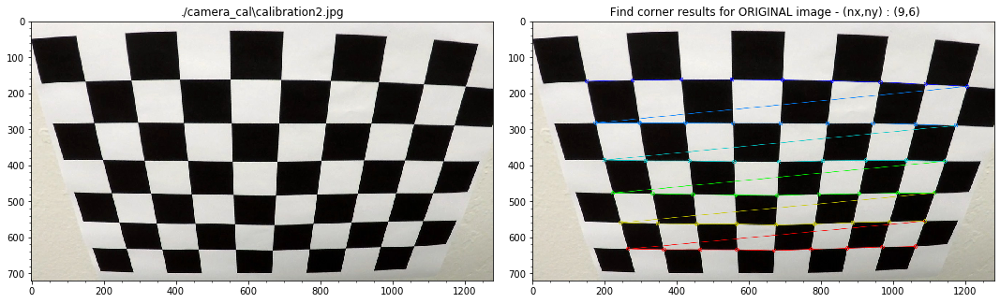

 displayChessboardCorners()
   nx: 9  ny: 6  imgResult.shape: (720, 1280, 3) 
   Image  :  ./camera_cal\calibration2.jpg corners:  ---------    ret    :  False nx/ny:  9 6


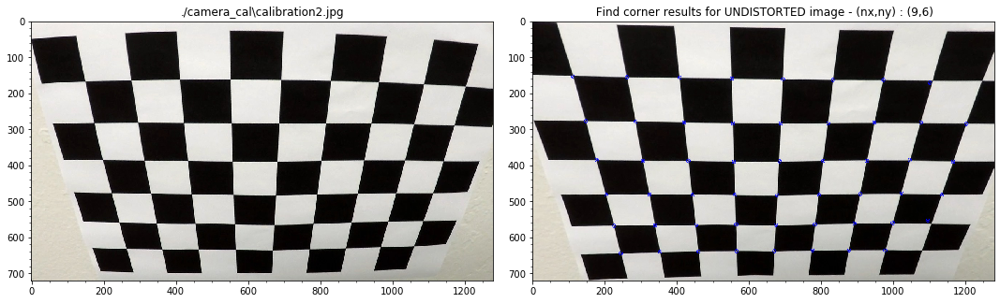

 displayChessboardCorners()
   nx: 8  ny: 6  imgResult.shape: (720, 1280, 3) 
   Image  :  ./camera_cal\calibration2.jpg corners:  (48, 1, 2)  ret    :  True nx/ny:  8 6


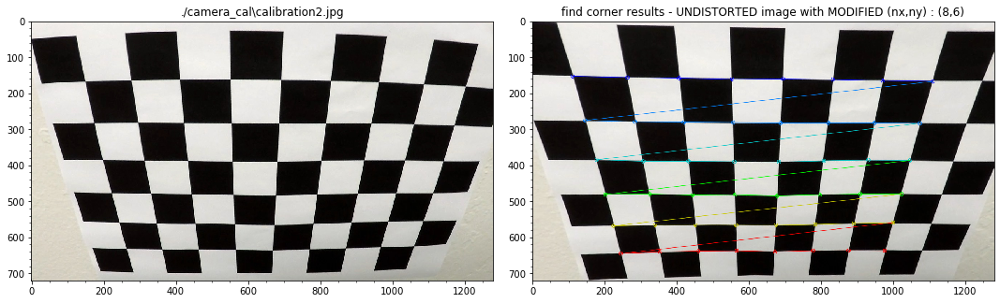

In [43]:
idx = 10
img = calImages[idx]

ret, origImgCorners = img.displayChessboardCorners(undistort = False, cam = camera0, debug = True)
display_two(img.imgOrig, origImgCorners, title1 = img.filename,  size = (15,10), 
            title2 = ' Find corner results for ORIGINAL image - (nx,ny) : ('+str(img.nx)+','+str(img.ny)+')')     

ret, undistImgCorners1 = img.displayChessboardCorners(undistort = True, cam = camera0, debug = True)
display_two(img.imgOrig, undistImgCorners1, title1 = img.filename, size = (15,10), 
            title2 = ' Find corner results for UNDISTORTED image - (nx,ny) : ('+str(img.nx)+','+str(img.ny)+')')     

nx =  8; ny = 6;
ret, undistImgCorners2 = img.displayChessboardCorners(undistort = True, cam = camera0, nx = nx, ny = ny,debug = True)
display_two(img.imgOrig, undistImgCorners2, title1 = img.filename, size = (15,10), 
            title2 = 'find corner results - UNDISTORTED image with MODIFIED (nx,ny) : ('+str(nx)+','+str(ny)+')')     

# Camera Calibration - II

Here we adjust the nx, ny parameters based on the individual image, so as to avoid corner detection failure for any individual image

##  Instantiate `Camera` Class

In [2]:
try: 
    del camera1
except: 
    print(' Camera1 object doesnt exist')
finally:
    camera1 = Camera(width = 1280, height = 720)
    print(' Camera1 object created')


 Camera1 object doesnt exist
 Camera1 object created


## Read chessboard images and detect corners

Here we modify the nx and ny parameters such that no calibration image fails the corner detection process. 


 Calibration image  0  File name:  ./camera_cal\calibration1.jpg (nx,ny): ( 9 , 5 )
     Corners Detection Successful


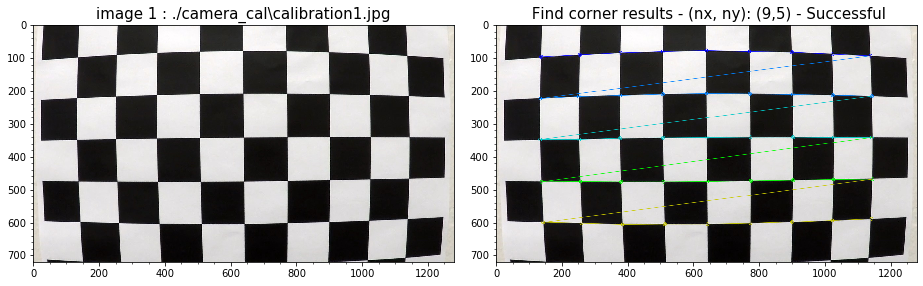


 Calibration image  1  File name:  ./camera_cal\calibration10.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


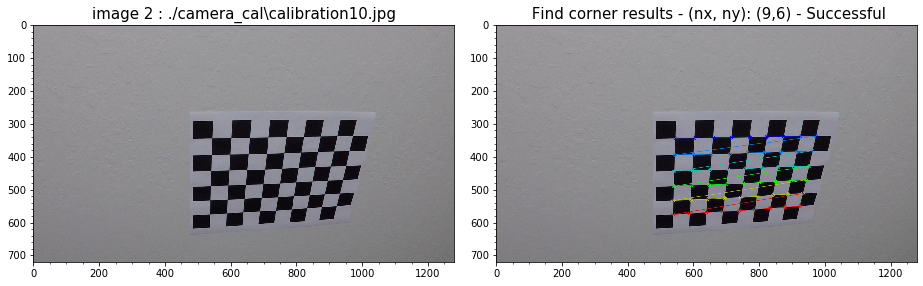


 Calibration image  2  File name:  ./camera_cal\calibration11.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


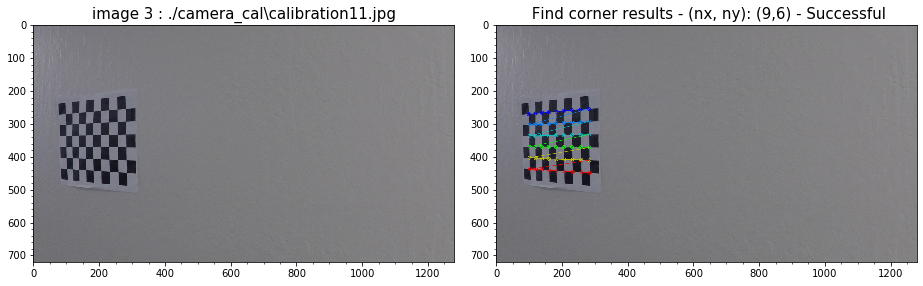


 Calibration image  3  File name:  ./camera_cal\calibration12.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


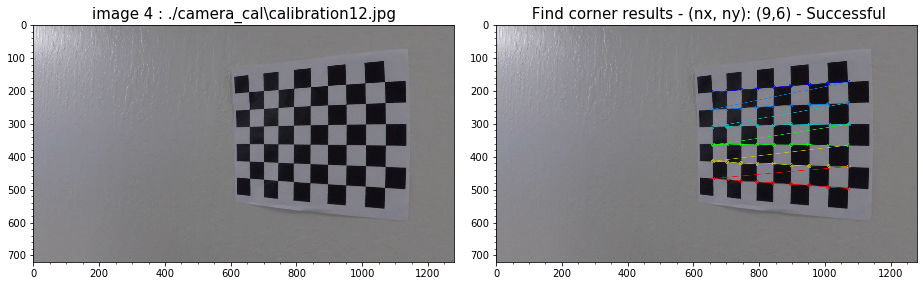


 Calibration image  4  File name:  ./camera_cal\calibration13.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


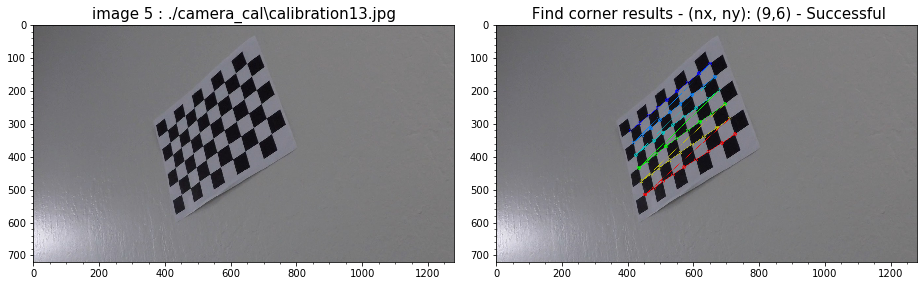


 Calibration image  5  File name:  ./camera_cal\calibration14.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


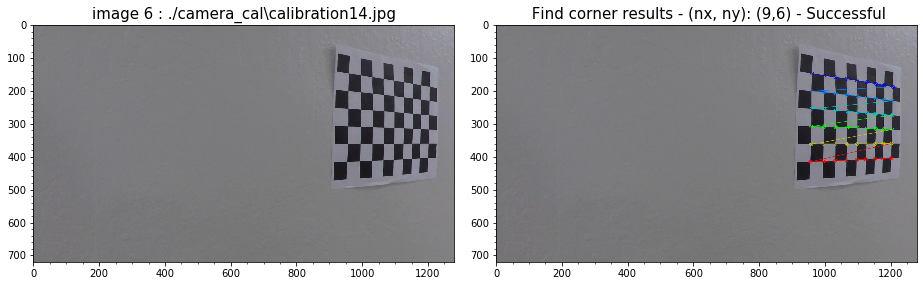


 Calibration image  6  File name:  ./camera_cal\calibration15.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


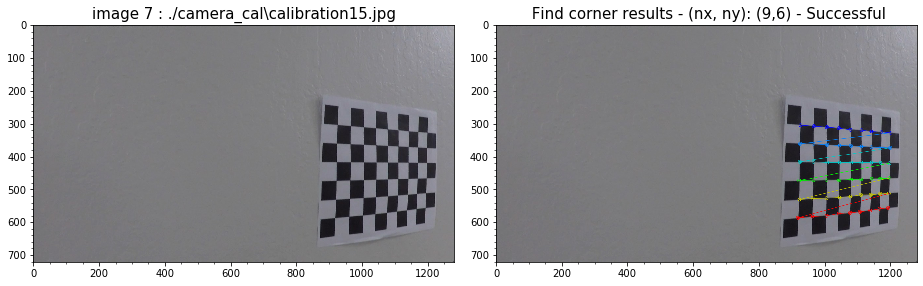


 Calibration image  7  File name:  ./camera_cal\calibration16.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


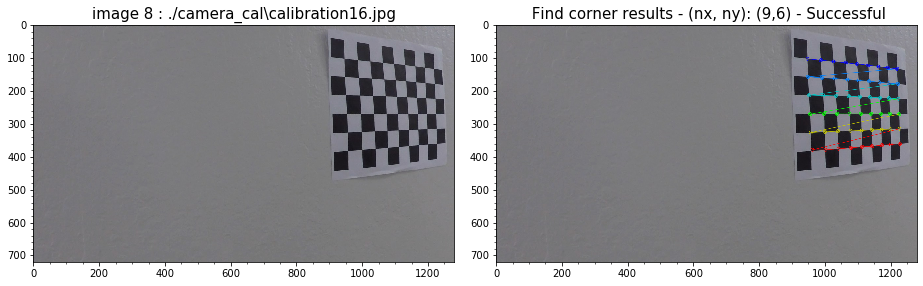


 Calibration image  8  File name:  ./camera_cal\calibration17.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


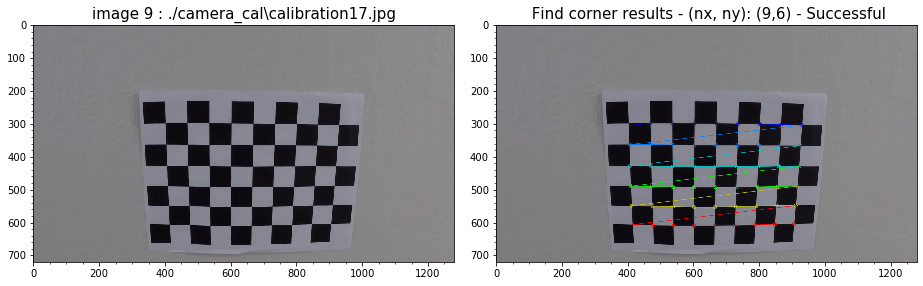


 Calibration image  9  File name:  ./camera_cal\calibration18.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


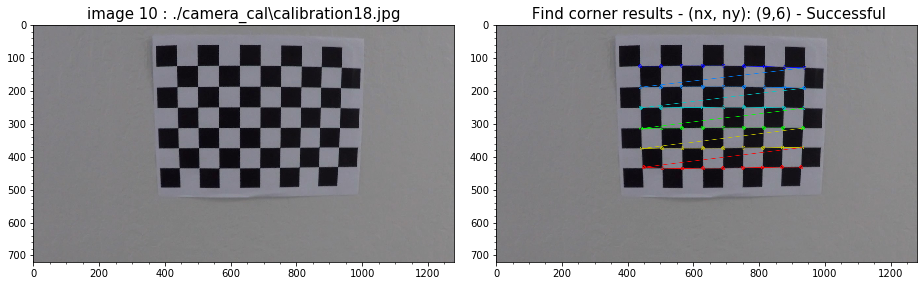


 Calibration image  10  File name:  ./camera_cal\calibration19.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


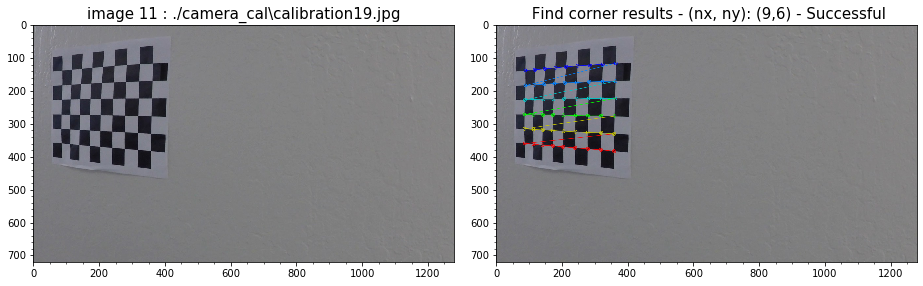


 Calibration image  11  File name:  ./camera_cal\calibration2.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


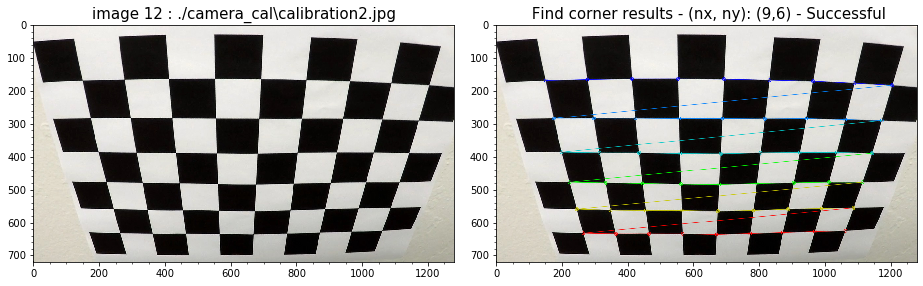


 Calibration image  12  File name:  ./camera_cal\calibration20.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


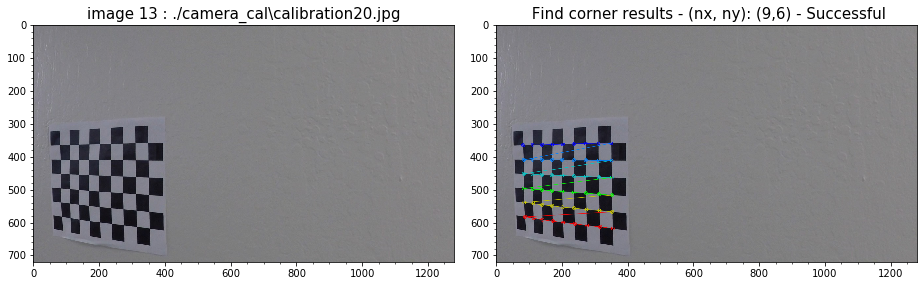


 Calibration image  13  File name:  ./camera_cal\calibration3.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


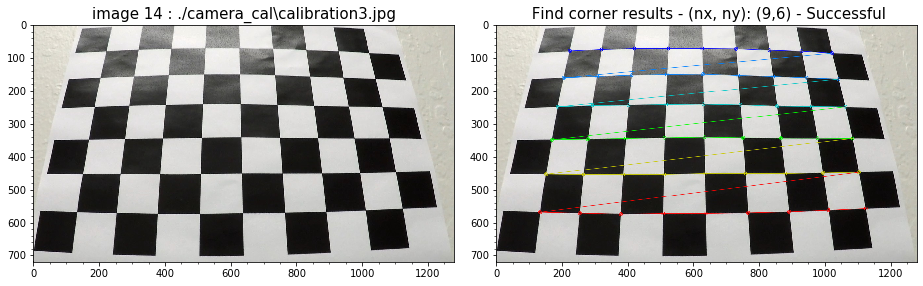


 Calibration image  14  File name:  ./camera_cal\calibration4.jpg (nx,ny): ( 6 , 4 )
     Corners Detection Successful


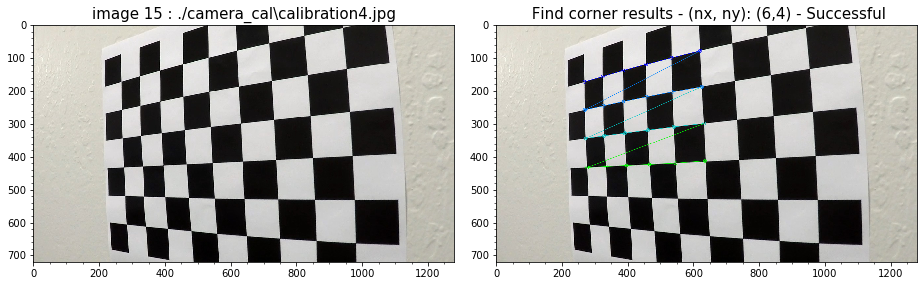


 Calibration image  15  File name:  ./camera_cal\calibration5.jpg (nx,ny): ( 7 , 6 )
     Corners Detection Successful


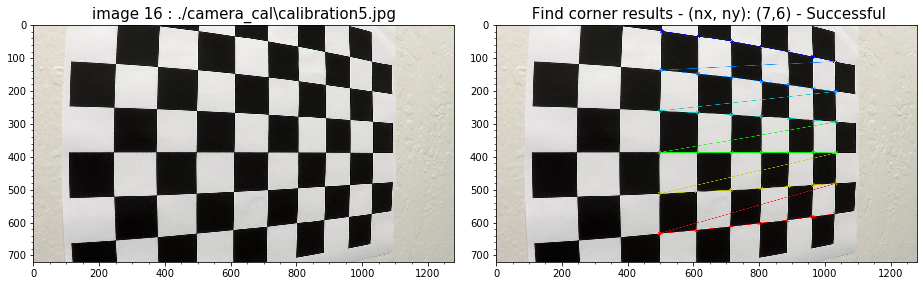


 Calibration image  16  File name:  ./camera_cal\calibration6.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


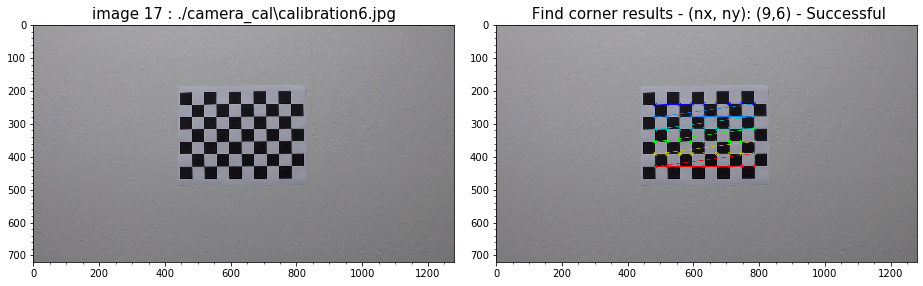


 Calibration image  17  File name:  ./camera_cal\calibration7.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


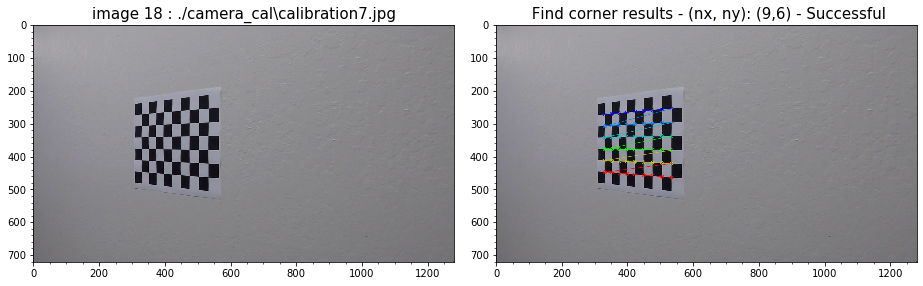


 Calibration image  18  File name:  ./camera_cal\calibration8.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


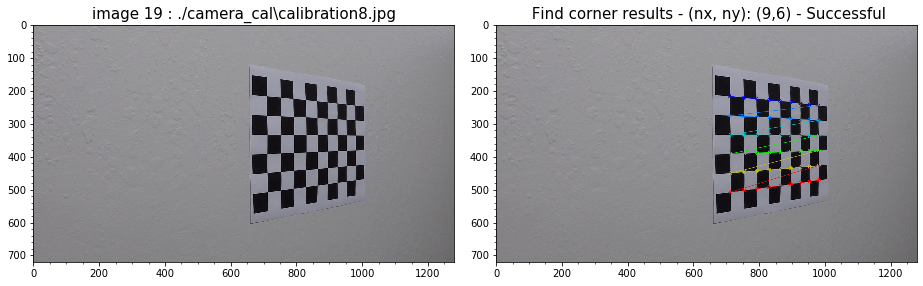


 Calibration image  19  File name:  ./camera_cal\calibration9.jpg (nx,ny): ( 9 , 6 )
     Corners Detection Successful


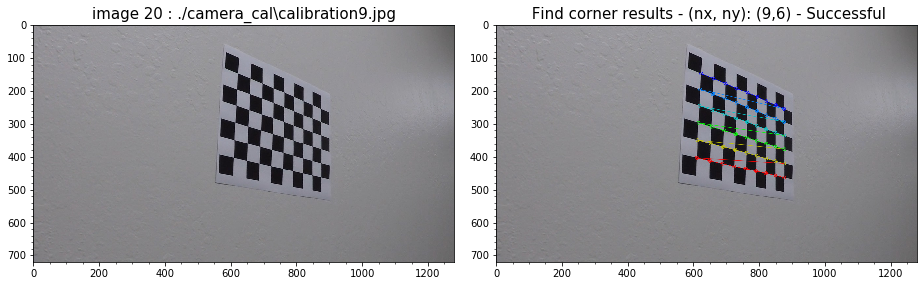

 Total succeeded 20   Total Failed 0


In [10]:
calImages1 = []
ttlSuccess = 0
ttlFailed  = 0 
for idx, imageName in enumerate(imageNames):
    if idx  == 0:
        nx = 9; ny = 5  ## (9,4), (9,5)
    elif idx == 14:
        nx = 6; ny = 4  ## (6,3)  (6,4) (6,5) (7,4)
    elif idx == 15:
        nx = 7; ny = 6  ## (7,5) (7,6)
    else: 
        nx = 9; ny = 6
    image = CalibrationImage(imageNames[idx])
    print('\n Calibration image ', idx ,' File name: ', image.filename, '(nx,ny): (', nx,',',ny,')')
    
    ret = image.findChessboardCorners(nx,ny, save = True, debug = False)

    if ret: 
        print('     Corners Detection Successful')
        ttlSuccess +=1
        calImages1.append(image)
    else: 
        print('     Corner Detection FAILED for ', image.filename)
        ttlFailed +=1

    _, dispImg  = image.displayChessboardCorners()
    display_two(image.imgOrig, dispImg, size=(13,7),
            title1 = 'image '+str(idx+1)+' : '+image.filename,
            title2 = ' Find corner results - (nx, ny): (' +str(image.nx)+',' +str(image.ny)+')'+ (' - Successful' if ret else ' - FAILED'))           
                
print(' Total succeeded {}   Total Failed {}'.format(ttlSuccess, ttlFailed))

## Display Images & detected corners 

### Display selected corners for all images 

In [ ]:
for idx,image in enumerate(calImages1):  
    print(image.filename, nx,ny, image.nx, image.ny)
    inputImg, dispImg  = image.displayChessboardCorners()
    display_two(inputImg, dispImg, 
                title1 = 'image '+str(idx)+' : '+image.filename,
                title2 = ' Find corner results - (nx, ny): (' +str(image.nx)+',' +str(image.ny)+')')        

### Display detected corners for selected images 

In [ ]:
for idx in [0,11, 14,15,16]:  
    if idx  == 0:
        nx = 9; ny = 5 
    elif idx == 14:
        nx = 6; ny = 4  ## (6,3)  (6,4) (6,5) (7,4)
#         nx = 7; ny = 4  ## (6,3)  (6,4) (6,5) (7,4)\
#         nx = 7; ny = 4 
    elif idx == 15:
        nx = 7; ny = 6  ## (7,5) (7,6)
#         nx = 9; ny = 5
    else: 
        nx = 9; ny = 6
    image = calImages1[idx]
    print(image.filename, nx,ny, image.nx, image.ny)
    inputImg, dispImg  = image.displayChessboardCorners(nx = nx, ny= ny, debug = True)
    display_two(inputImg, dispImg, 
                title1 = image.filename+'   NX: ' +str(image.nx)+' NY: ' +str(image.ny), 
                title2 = ' Find checkerboard corner results')    

## Calibrate Camera 

Using the checkerboard transformation points from images that were sucessfully corner detected 

In [ ]:
camera1.calibrate(calImages1)

## Undistort image and detect/display corners
(Needs Camera Calibration params first)

Camera must be calibrated to run this code segment, as it attmepts to undistort an image

In [ ]:
# for idx in [0,14,15,16]:  
# for idx in [1]:  
    idx  = 14
    if idx  == 0:
        nx = 9; ny = 5  ## (9,4), (9,5)
    elif idx == 11:
        nx = 8; ny = 6
    elif idx == 14:
        nx = 6; ny = 4 ## (6,3)  (6,4) (6,5) (7,4)
#         nx = 7; ny = 4  ## (6,3)  (6,4) (6,5) (7,4)\
#         nx = 7; ny = 4 
    elif idx == 15:
        nx = 7; ny = 6  ## (7,5) (7,6)
    else: 
        nx = 9; ny = 6
    
    imgObj    = CalibrationImage(imageNames[idx])
    print(imgObj.filename, 'nx: ', nx, 'ny: ', ny)    

    inputImg  = imgObj.getImage()
    undistImg = camera1.undistortImage(inputImg)
    display_two(inputImg, undistImg,      
                title1 = 'image '+str(idx)+' : '+image.filename+' - original',
                title2 = 'Undistorted image')
            
    ret = imgObj.findChessboardCorners(img = undistImg, nx = nx, ny = ny, save = False, debug = True)
    if ret: 
        print('\n Idx : ', idx ,' File name: ', image.filename,'nx: ', image.nx, 'ny: ', image.ny, ' findCorners result: ' , image.PtrnFnd, ' ret :', ret)
        
        inputImg, resultImg  = imgObj.displayChessboardCorners(undistort = True, nx = nx, ny = ny, cam = camera1,  debug = True)
        display_two(inputImg, resultImg, 
                title1 = 'Undistorted image ',
                title2 = 'Undistorted image corner results - (nx, ny): (' +str(image.nx)+',' +str(image.ny)+')')    
    else: 
        print('\n Idx : ', idx ,' File name: ', image.filename, '  - Corner Detection Failed')

    

## Display undistorted Images & detected corners 

### Display undistorted images with detected corner points

In [ ]:
for idx,image in enumerate(calImages1):
    if idx  == 0:
        nx = 9; ny = 5  ## (9,4), (9,5)
    elif idx == 11:
        nx = 8; ny = 6
    elif idx == 14:
        nx = 6; ny = 4 ## (6,3)  (6,4) (6,5) (7,4)
    elif idx == 15:
        nx = 7; ny = 6  ## (7,5) (7,6)
    else: 
        nx = 9; ny = 6
        
#     print(' idx: ', idx, ' Filename :', image.filename, '   nx: ', nx, '   ny: ', ny)
    inputImg, dispImg  = image.displayChessboardCorners(undistort = True, cam = camera1, nx = nx, ny = ny, debug = False)
    display_two(inputImg, dispImg,                
                title1 = 'image '+str(idx)+' : '+image.filename+' - original',
                title2 = 'Undistorted image corner results - (nx, ny): (' +str(image.nx)+',' +str(image.ny)+')')        

### Display undistorted images with detected corner points

In [ ]:
for idx,  (nx,ny) in zip([14,15,0], [(8,6), (9,6), (9,5)]):
            image = CalibrationImage(imageNames[idx])
            print(' idx: ', idx, ' Filename :', imageNames[idx], '   nx: ', nx, '   ny: ', ny)
            origImg, undistImg = image.displayChessboardCorners(undistort = True, cam = camera1, nx = nx, ny = ny)
            display_two(origImg, undistImg,
                title1 = 'image '+str(idx)+' : '+image.filename+' - original',
                title2 = 'Undistorted image corner results - (nx, ny): (' +str(image.nx)+',' +str(image.ny)+')')       

In [ ]:
print(camera0.calib_RMS)
print()
print(camera0.cameraMatrix)
print()
print(camera1.calib_RMS)
print(camera1.cameraMatrix)

## Save camera info to config file

`cameraconfig_1.pkl` : Calibration computed including images with nx/ny parms  other than nx = 9, ny = 6

In [1]:
with open('./cameraConfig_1_new.pkl', 'wb+') as outfile:
    pickle.dump(camera1, outfile)

NameError: name 'pickle' is not defined

## Load camera info from config file

In [ ]:
imageList = glob.glob('./camera_cal/calibration*.jpg')
imageCount = len(imageList)
imageIndexes = range(imageCount)

In [ ]:
try: 
    del camera1
except: 
    print(' object doesnt exist')
    pass
with open('./camera_cal/cameraConfig_1.pkl', 'rb') as infile:
    camera1 = pickle.load(infile)
print(camera1.cameraMatrix)

## Display original and undistorted image

In [ ]:
# %matplotlib inline
imgIdxs = [11]
for idx in imgIdxs:
    inputImg = calImages1[idx].getImage()
    undistImg = camera1.undistortImage(inputImg)
    display_two(inputImg, undistImg, title1 = ' input: '+calImages1[idx].filename , title2 = ' undistorted image ')
#     display_one(undistImg, title = ' input: '+calImages[idx].filename , color = True)

## Undistort images, detect and display corners on undistorted image

In [ ]:
# %matplotlib inline
imgIdxs = [0,11,13,14,15,16]
imgIdxs = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19]
nx = 9; ny = 6 

# for idx in [0,12,13,14,15]:
for idx, image in enumerate(calImages1):
    if idx  == 0:
        nx = 9; ny = 5  ## (9,4), (9,5)
    elif idx == 14:
        nx = 8; ny = 6  ## (6,3)  (6,4) (6,5) (7,4)
    elif idx == 15:
        nx = 5; ny = 3  ## (7,5) (7,6)
    else: 
        nx = 9; ny = 6 
        
    origImg, undistImg = image.displayChessboardCorners(undistort = True, cam = camera1, nx = nx, ny = ny)
    display_two(origImg, undistImg, title1 = image.filename , title2 = ' Find checkerboard corner results')    

## Display corners on undistorted image

In [ ]:
# %matplotlib inline
imgIdxs = [0,11,13,14,15,16]
imgIdxs = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19]

print(nx,ny)
# for idx in range(len(calImages)):
for idx in [14]:
    img = calImages[idx]
    origImg, undistImg = img.displayChessboardCorners(undistort = True, cam = camera, nx = nx, ny = ny)
    display_two(origImg, undistImg, title1 = img.filename , title2 = ' Find checkerboard corner results')     

# Perspective Transformation on Checkerboard Images 

In [2]:
try: 
    del camera0
except: 
    print(' object doesnt exist')
    pass
with open('./camera_cal/cameraConfig_0.pkl', 'rb') as infile:
    camera0 = pickle.load(infile)
print(camera0.cameraMatrix)

 object doesnt exist
[[1.15777818e+03 0.00000000e+00 6.67113857e+02]
 [0.00000000e+00 1.15282217e+03 3.86124583e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


 Idx :  0  filename:  ./camera_cal\calibration1.jpg
 img shape:  (720, 1280, 3)  Corners detected:  45  M: (3, 3)
 src point (corner  0, 0): [   89.33    72.52]  tranformed to  dst point: [  100.00    50.00]
 src point (corner  8, 0): [ 1170.34    72.87]  tranformed to  dst point: [ 1200.00    50.00]
 src point (corner 36, 0): [  104.29   615.18]  tranformed to  dst point: [  100.00   670.00]
 src point (corner 44, 0): [ 1166.54   600.58]  tranformed to  dst point: [ 1200.00   670.00]


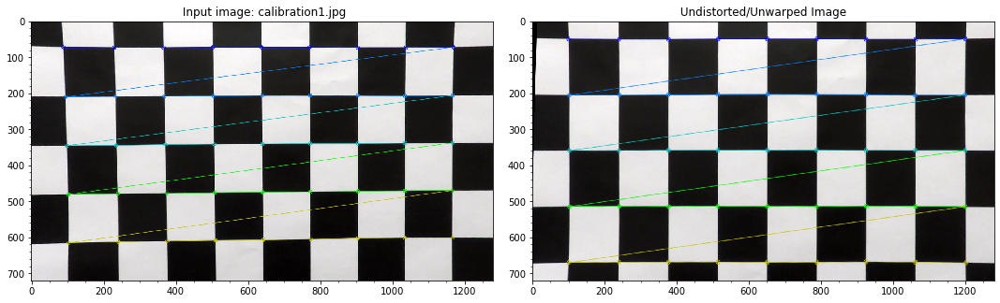

 Idx :  11  filename:  ./camera_cal\calibration2.jpg
 img shape:  (720, 1280, 3)  Corners detected:  48  M: (3, 3)
 src point (corner  0, 0): [  111.14   154.15]  tranformed to  dst point: [  100.00    50.00]
 src point (corner  7, 0): [ 1109.48   168.15]  tranformed to  dst point: [ 1200.00    50.00]
 src point (corner 40, 0): [  244.74   645.28]  tranformed to  dst point: [  100.00   670.00]
 src point (corner 47, 0): [  975.50   637.00]  tranformed to  dst point: [ 1200.00   670.00]


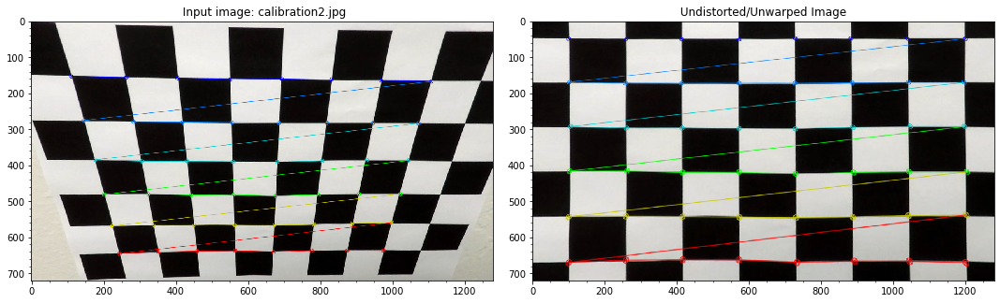

 Idx :  12  filename:  ./camera_cal\calibration20.jpg
 img shape:  (720, 1280, 3)  Corners detected:  54  M: (3, 3)
 src point (corner  0, 0): [   33.42   363.81]  tranformed to  dst point: [  100.00    50.00]
 src point (corner  8, 0): [  343.97   358.10]  tranformed to  dst point: [ 1200.00    50.00]
 src point (corner 45, 0): [   32.89   600.83]  tranformed to  dst point: [  100.00   670.00]
 src point (corner 53, 0): [  344.85   625.85]  tranformed to  dst point: [ 1200.00   670.00]


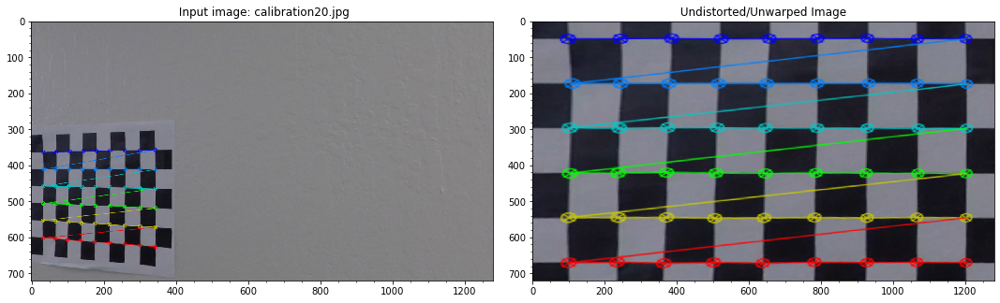

 Idx :  13  filename:  ./camera_cal\calibration3.jpg
 img shape:  (720, 1280, 3)  Corners detected:  54  M: (3, 3)
 src point (corner  0, 0): [  195.32    58.41]  tranformed to  dst point: [  100.00    50.00]
 src point (corner  8, 0): [ 1037.88    71.49]  tranformed to  dst point: [ 1200.00    50.00]
 src point (corner 45, 0): [   93.70   581.31]  tranformed to  dst point: [  100.00   670.00]
 src point (corner 53, 0): [ 1147.24   567.34]  tranformed to  dst point: [ 1200.00   670.00]


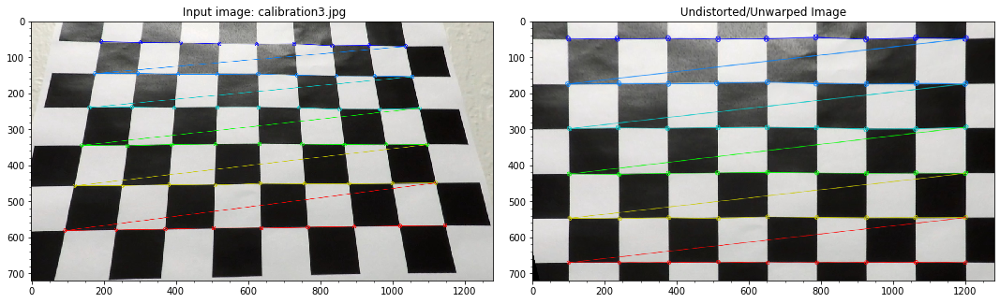

 Idx :  14  filename:  ./camera_cal\calibration4.jpg
 img shape:  (720, 1280, 3)  Corners detected:  48  M: (3, 3)
 src point (corner  0, 0): [  252.59   161.71]  tranformed to  dst point: [  100.00    50.00]
 src point (corner  7, 0): [  828.00    23.00]  tranformed to  dst point: [ 1200.00    50.00]
 src point (corner 40, 0): [  269.04   615.56]  tranformed to  dst point: [  100.00   670.00]
 src point (corner 47, 0): [  863.58   662.66]  tranformed to  dst point: [ 1200.00   670.00]


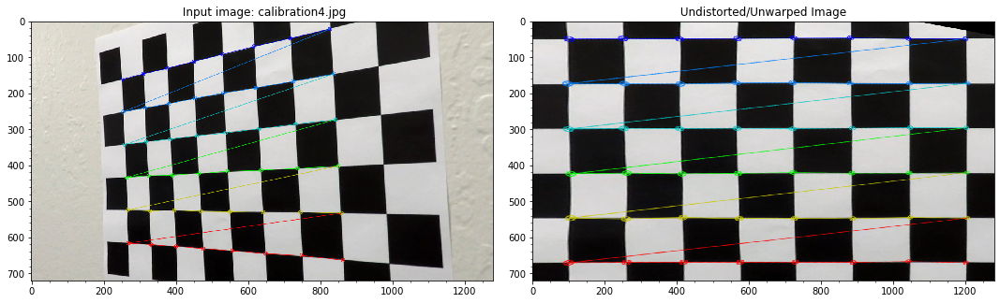

 Idx :  15  filename:  ./camera_cal\calibration5.jpg


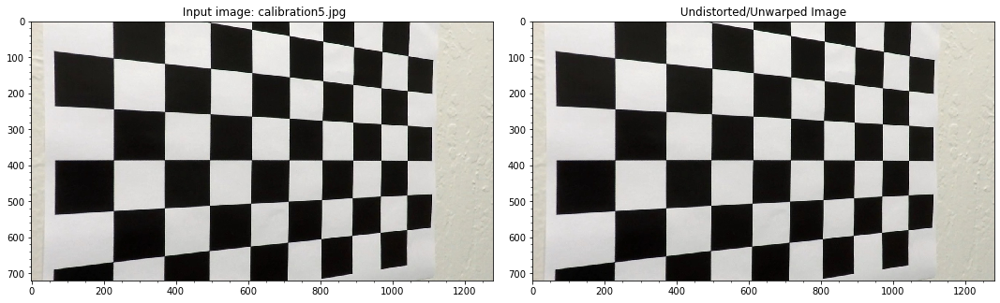

 Idx :  16  filename:  ./camera_cal\calibration6.jpg
 img shape:  (720, 1280, 3)  Corners detected:  54  M: (3, 3)
 src point (corner  0, 0): [  480.69   240.49]  tranformed to  dst point: [  100.00    50.00]
 src point (corner  8, 0): [  784.72   238.31]  tranformed to  dst point: [ 1200.00    50.00]
 src point (corner 45, 0): [  482.46   429.69]  tranformed to  dst point: [  100.00   670.00]
 src point (corner 53, 0): [  785.82   428.24]  tranformed to  dst point: [ 1200.00   670.00]


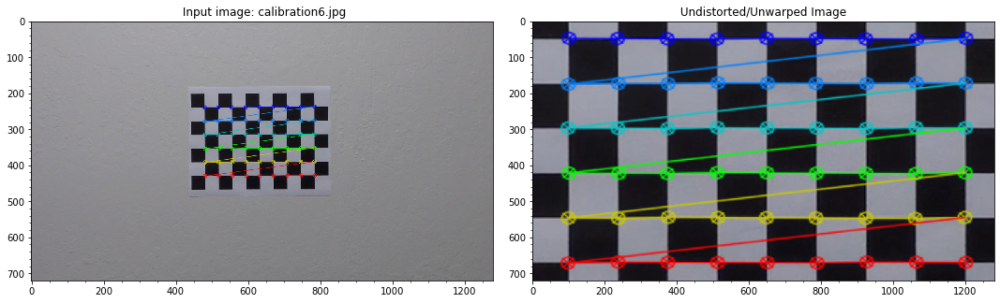

In [89]:
destPoints = np.float32([[100,50],[1200,50],[100,670],[1200,670]])
nx = 9; ny = 6 
# for idx in [0,1,2,3,4,5,6,7,8,9,10]:
# for idx in [8,9,10,12,13,14,15,16,17,18,19]:
for idx in [0,11,12,13,14,15,16]:
# for idx in [15]:
    filename = os.path.split(imageNames[idx])[-1]
    print(' Idx : ', idx, ' filename: ', imageNames[idx], )

    if idx  == 0:
        nx = 9; ny = 5  ## (9,4), (9,5)
    elif idx == 11:
        nx = 8; ny = 6
    elif idx == 14:
        nx = 8; ny = 6  ## (6,3)  (6,4) (6,5) (7,4)
    elif idx == 15:
        nx = 5; ny = 3 ## (7,5) (7,6)
    else: 
        nx = 9; ny = 6 
        
    imgObj = CalibrationImage(imageNames[idx] )
    img1, img2, M = unwarpImage(imgObj.imgOrig, nx = nx, ny = ny, cam = camera0, dst = destPoints, debug = True)
    display_two(img1, img2, size=(15,10), 
                title1 = ' Input image: '+ filename , title2 = ' Undistorted/Unwarped Image ')